In [1]:
from collections import defaultdict
import regex as re
import toolz
from dataclasses import dataclass, asdict
from functools import reduce
import random
import matplotlib.pyplot as plt
from matplotlib.legend import Legend
import typing
import numpy as np

In [2]:
quantified_peptides_path = r"B:\Users\Peter\Claire_multiprotease_ULB-Virions\ULB_eFASP_multiprotease\2025-05-14-10-54-29\Task2-SearchTask\AllQuantifiedPeptides.tsv"
experimental_design_path = r"B:\Users\Peter\Claire_multiprotease_ULB-Virions\ULB_eFASP_multiprotease\ExperimentalDesign.tsv"


with open(experimental_design_path, 'r') as f:
    rows = f.readlines()
    exp_headers = rows[0].strip('\n').lower().split('\t')
    design_info = defaultdict(dict)

    for r in rows[1:]:
        r = r.strip('\n').split('\t')
        info = dict(zip(exp_headers, r))
        design_info[r[0]] = info


with open(quantified_peptides_path, 'r') as f:
    rows = f.readlines()
    print(len(rows))
    data_headers = rows[0].strip('\n').replace(' ', '_').lower().split('\t')

    data = defaultdict(dict)
    for r in rows[1:]:
        r = r.strip('\n').split('\t')
        fullSeq = r[0]
        baseSeq = r[1]
        info = dict(zip(data_headers, r))
        
        data[baseSeq][fullSeq] = info

17328


In [82]:
def get_mods(fullSeq: str):
    mod_pattern = r"-?\[.+?\](?<!\[I+\])"
    mods = re.findall(mod_pattern, fullSeq)
    splits = re.split(mod_pattern, fullSeq)
    print(mods, splits)
    
    m = {}
    running_length = 0
    for i, mod in enumerate(mods):
        running_length += len(splits[i])
        if mod.startswith('-'): 
            running_length += 1
        m[running_length] = re.sub(r'-?\[|\]', '', mod)
        
    return m

@dataclass
class SpectraFileInfo:
    filename: str
    condition: int
    biorep: int
    techrep: int
    fraction: int


class Peptide:
    def __init__(self, 
                 sequence: str, 
                 base_sequence: str, 
                 protein_groups: str,
                 gene_names: str = '', 
                 organism: str = '', 
                 spectrafiles: dict[str, SpectraFileInfo] = dict(),
                 intensities_per_file: dict[str, float] = dict(), 
                 detectiontypes_per_file: dict[str, str] = dict()):
        
        self.sequence = sequence
        self.base_sequence = base_sequence
        self.protein_groups = protein_groups
        self.gene_names = gene_names
        self.organism = organism
        self.spectrafiles = spectrafiles
        self.intensities_per_file = intensities_per_file
        self.detectiontypes_per_file = detectiontypes_per_file

    def group_spectrafiles(self, group_keys: list) -> None:
        self.group_keys_labels = group_keys
        files = [asdict(f) for f in spectrafiles.values()]
        reduced_group_sums = toolz.reduceby(group_keys, 
                                            lambda acc, x: [acc[0]+1, 
                                                            acc[1]+self.intensities_per_file[x['filename']]],
                                            files, [0, 0])
        self.reduced_intensities = toolz.valmap(lambda x: x[1]/x[0] if x[0]!=0 else 0, reduced_group_sums) #prevent div by 0 errors
        

    def normalize_file_intensities(self, norms: dict[str, float]):
        self.normalized_intensities_per_file = dict()
        for f in self.spectrafiles:
            self.normalized_intensities_per_file[f] = self.intensities_per_file[f]*norms[f]

    def __repr__(self) -> str:
        return "PeptideObj: "+self.sequence


class BasePeptide: 
    def __init__(self, peptides: list[Peptide]):
        self.modified_peptides = peptides


class ProteinGroup:
    def __init__(self, name: str, peptides: list[Peptide]):
        self.proteingroup_name = name
        self.peptides = peptides
        self.spectrafiles = peptides[0].spectrafiles

    # NEED TO FIX THIS. NORMS ARE 0 FOR SOME REASON. 
    def normalize_intensities(self, good_thresh=0.1):

        # get mean deviations
        imds = dict()
        total = len(self.peptides)
        mean_per_files = {f: sum([p.intensities_per_file[f] for p in peptides])/total for f in self.spectrafiles}
        for p in self.peptides:
            imds[p] = {f: mean_per_files[f] - p.intensities_per_file[f] for f in self.spectrafiles}

        # get relative median deviations for the means
        median_deviations_per_file: dict[str, float] = dict()
        for f in spectrafiles:
            median_deviations_per_file[f] = np.median([imds[p][f] for p in self.peptides])

        good_bad_per_file = dict()
        for f in self.spectrafiles:
            good_bad_per_file[f] = [[], []]
            for p in self.peptides:
                if abs(imds[p][f]-median_deviations_per_file[f]) < good_thresh:
                    good_bad_per_file[f][0].append(p)
                else:
                    good_bad_per_file[f][1].append(p)
        #return good_bad_per_file
        self.norms_per_file = dict()
        for f in self.spectrafiles:
            total_good_intensity = sum([p.intensities_per_file[f] for p in good_bad_per_file[f][0]])
            self.norms_per_file[f] = total_good_intensity
        print([len(good_bad_per_file[f][0]) for f in good_bad_per_file])
        print(self.norms_per_file)
        for p in self.peptides: 
            p.normalize_file_intensities(self.norms_per_file)
        
            
        
    
    def __repr__(self):
        return 'ProteinGroupObj ' + self.proteingroup_name + f' w/ {len(self.peptides)} peptides.'


def first(d: dict):
    k = next(iter(d))
    return (k, d[k])

In [69]:
get_mods('[UniProt:N-acetylalanine on A]AADISQWAGPLC[Common Fixed:Carbamidomethyl on C]LQEVDEPPQHALR[TEST1]-[TEST2]')

['[UniProt:N-acetylalanine on A]', '[Common Fixed:Carbamidomethyl on C]', '[TEST1]', '-[TEST2]'] ['', 'AADISQWAGPLC', 'LQEVDEPPQHALR', '', '']


{0: 'UniProt:N-acetylalanine on A',
 12: 'Common Fixed:Carbamidomethyl on C',
 25: 'TEST1',
 26: 'TEST2'}

In [26]:
data

defaultdict(dict,
            {'CADDRADLAKYICENQDSISSKLKE': {'[Common Artifact:Ammonia loss on C]C[Common Fixed:Carbamidomethyl on C]ADDRADLAKYIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE': {'sequence': '[Common Artifact:Ammonia loss on C]C[Common Fixed:Carbamidomethyl on C]ADDRADLAKYIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE',
               'base_sequence': 'CADDRADLAKYICENQDSISSKLKE',
               'protein_groups': 'P02768',
               'gene_names': 'ALB',
               'organism': 'Homo sapiens',
               'intensity_08-27-24_b_efasp-bio1_chtryp_hcd-calib': '0',
               'intensity_08-28-24_b_efasp-bio1_chtryp_ethcd-calib': '0',
               'intensity_08-21-24_b_efasp-bio2_chtryp_hcd-calib': '0',
               'intensity_08-21-24_b_efasp-bio2_chtryp_ethcd-calib': '0',
               'intensity_08-21-24_b_efasp-bio3_chtryp_hcd-calib': '0',
               'intensity_08-21-24_b_efasp-bio3_chtryp_ethcd-calib': '0',
               'intensity_08-27-24_b_

In [27]:
design_info

defaultdict(dict,
            {'08-17-24_B_eFASP-bio2_Tryp_EThcD-calib.mzML': {'filename': '08-17-24_B_eFASP-bio2_Tryp_EThcD-calib.mzML',
              'condition': 'B_T',
              'biorep': '2',
              'fraction': '1',
              'techrep': '2'},
             '08-17-24_B_eFASP-bio2_Tryp_HCD-calib.mzML': {'filename': '08-17-24_B_eFASP-bio2_Tryp_HCD-calib.mzML',
              'condition': 'B_T',
              'biorep': '2',
              'fraction': '1',
              'techrep': '1'},
             '08-17-24_B_eFASP-bio3_Tryp_EThcD-calib.mzML': {'filename': '08-17-24_B_eFASP-bio3_Tryp_EThcD-calib.mzML',
              'condition': 'B_T',
              'biorep': '3',
              'fraction': '1',
              'techrep': '2'},
             '08-17-24_B_eFASP-bio3_Tryp_HCD-calib.mzML': {'filename': '08-17-24_B_eFASP-bio3_Tryp_HCD-calib.mzML',
              'condition': 'B_T',
              'biorep': '3',
              'fraction': '1',
              'techrep': '1'},
          

In [83]:
peptides = []
spectrafiles = {f: SpectraFileInfo(**design_info[f]) for f in design_info}

for p in data:
    for seq in data[p]:
        peptide_info = {k:v for k,v in data[p][seq].items() if not k.startswith("intensity_") and not k.startswith("detection_type_")}
        
        intensities_per_file = {f: float(data[p][seq]['intensity_'+f.strip('.mzML').lower()]) for f in design_info.keys()}
        detections_per_file = {f: data[p][seq]['detection_type_'+f.strip('.mzML').lower()] for f in design_info.keys()}
        peptides.append(Peptide(**peptide_info, 
                                spectrafiles = spectrafiles, 
                                intensities_per_file = intensities_per_file, 
                                detectiontypes_per_file = detections_per_file))

In [84]:
len(spectrafiles), len(peptides), len(rows)

(72, 17327, 17328)

In [85]:
grouped_peptides = defaultdict(dict)
missing_base_peptides = []
for p in peptides:
    grouped_peptides[p.base_sequence].update({p.sequence: p}) #store the sequence and the Peptide object

# Check how many unmodified peptides objects missing
num_base_peptides_missing = 0
for base_pep in grouped_peptides:
    if base_pep not in grouped_peptides[base_pep]: # check if base seq is in full seq keys
        missing_base_peptides.append(base_pep)
print(f"{len(peptides)} peptides are present in the data.")
print(f"{len(missing_base_peptides)} unmodified peptides whose modified peptidoforms were seen are missing.")

#mnei = 1e15 # Min Nonzero Experimental Intensity
#for p in peptides:
#    for i in p.intensities_per_file.values():
#        if 0.0<i<mnei:
#            mnei = i
#print(mnei) #27352.797526041668

# Inject those missing base sequence peptides with zero intensity into the peptide object list
for bp in missing_base_peptides:
    newPeptide = first(grouped_peptides[bp])[1]
    newPeptide.sequence = bp
    for f in newPeptide.spectrafiles: 
        newPeptide.intensities_per_file[f] = 0.0
        newPeptide.detectiontypes_per_file[f] = 'NonExperimentallyInjectedPeptide'
        
    peptides.append(newPeptide)
print(f"The new peptide total is {len(peptides)} after including the missing unmodified peptidoforms.")

17327 peptides are present in the data.
5067 unmodified peptides whose modified peptidoforms were seen are missing.
The new peptide total is 22394 after including the missing unmodified peptidoforms.


In [ ]:
xlabels = sorted(list(peptides[0].intensities_per_file.keys()))
xpts, ypts = zip(*[(xlabels.index(k), v) for p in peptides for k,v in p.intensities_per_file.items()])
fig, (ax, legend_box) = plt.subplots(1, 2, figsize=(10,10), width_ratios=(0.75, 0.25), layout='tight')
ax.plot(xpts, ypts, 'o', ms=1.5)
ax.set_ylim(min(ypts) - 5, max(ypts) + 5)
ax.set_title("Distribution of peptide intensities per file")
ax.set_xlabel("File (See Legend)")
ax.set_ylabel("Peptide Intensity")      

col_space = 8
legend_lines = [f"X{' '*(col_space-2)}filename"] + list(map(''.join, [[str(i), ' '*(col_space-2*len(str(i))), l] for i,l in enumerate(xlabels)]))
legend_lines = toolz.interpose('\n', legend_lines)
legend_box.text(0,0, ''.join(legend_lines), fontsize=7)
for i in legend_box.get_children()[1:]:
    i.set_visible(False)
plt.show()

In [86]:
pg_peptides = defaultdict(list)
for p in peptides:
    for pg in p.protein_groups.split(';'):
        pg_peptides[pg].append(p)

protein_groups = []
for pg in pg_peptides:
    protein_groups.append(ProteinGroup(pg, pg_peptides[pg]))

protein_groups

[ProteinGroupObj P02768 w/ 182 peptides.,
 ProteinGroupObj P02765 w/ 48 peptides.,
 ProteinGroupObj P08779 w/ 196 peptides.,
 ProteinGroupObj P00734 w/ 88 peptides.,
 ProteinGroupObj P68104 w/ 145 peptides.,
 ProteinGroupObj Q05639 w/ 60 peptides.,
 ProteinGroupObj P00740 w/ 13 peptides.,
 ProteinGroupObj P07900 w/ 124 peptides.,
 ProteinGroupObj P04004 w/ 25 peptides.,
 ProteinGroupObj P0DMV8|P0DMV9 w/ 143 peptides.,
 ProteinGroupObj P02787 w/ 202 peptides.,
 ProteinGroupObj P07737 w/ 26 peptides.,
 ProteinGroupObj P31948 w/ 14 peptides.,
 ProteinGroupObj P49006 w/ 18 peptides.,
 ProteinGroupObj P04585_IN_WTJB474 w/ 88 peptides.,
 ProteinGroupObj P04585_WTJB474 w/ 711 peptides.,
 ProteinGroupObj Q13835 w/ 39 peptides.,
 ProteinGroupObj P62258 w/ 41 peptides.,
 ProteinGroupObj P30273 w/ 2 peptides.,
 ProteinGroupObj A0M8Q6 w/ 5 peptides.,
 ProteinGroupObj P0DOY3 w/ 15 peptides.,
 ProteinGroupObj P46781 w/ 18 peptides.,
 ProteinGroupObj P08708 w/ 17 peptides.,
 ProteinGroupObj P09525 w/

In [66]:
good_bad_counts = {}
total = len(protein_groups)
count = 0
for i, pg in enumerate(protein_groups):
    print(i/total, end='\r')
    good_bad_counts[pg] = {}
    gbpf = pg.normalize_intensities()
    for f in gbpf:
        good_bad_counts[pg][f] = list(map(len, gbpf[f]))

ZeroDivisionError: float division by zero

ZeroDivisionError: division by zero

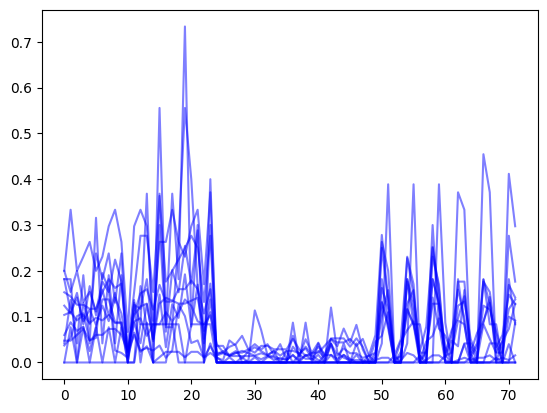

In [19]:
for pg in good_bad_counts:
    good_ypts, bad_ypts = list(zip(*[good_bad_counts[pg][f] for f in good_bad_counts[pg]]))
    xpts = range(len(xlabels))
    gb_ratio = [bad_ypts[i]/good_ypts[i] for i in range(len(good_ypts))]
    plt.plot(xpts, gb_ratio, c='b', alpha=0.5)

In [89]:
pg = protein_groups[0]
pg.normalize_intensities()

PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDR[Common Biological:Citrullination on R]ADLAKYIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE 27466600.4375
PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDR[Common Biological:Citrullination on R]ADLAKYIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE 14029942.28125
PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDRADLAK[Common Biological:Hydroxylation on K]YIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE 5773252.59375
PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDRADLAK[Common Biological:Hydroxylation on K]YIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE 46453872.375
PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDRADLAK[Common Biological:Hydroxylation on K]YIC[Common Fixed:Carbamidomethyl on C]ENQDSISSKLKE 16654448.5
PeptideObj: C[Common Fixed:Carbamidomethyl on C]ADDRADLAKYIC[Common Artifact:Carbamyl on C]ENQDSISSK[Common Biological:Methylation on K]LKE 13082585.84375
PeptideObj: C[Common Fixed:Carbamidomethyl on 

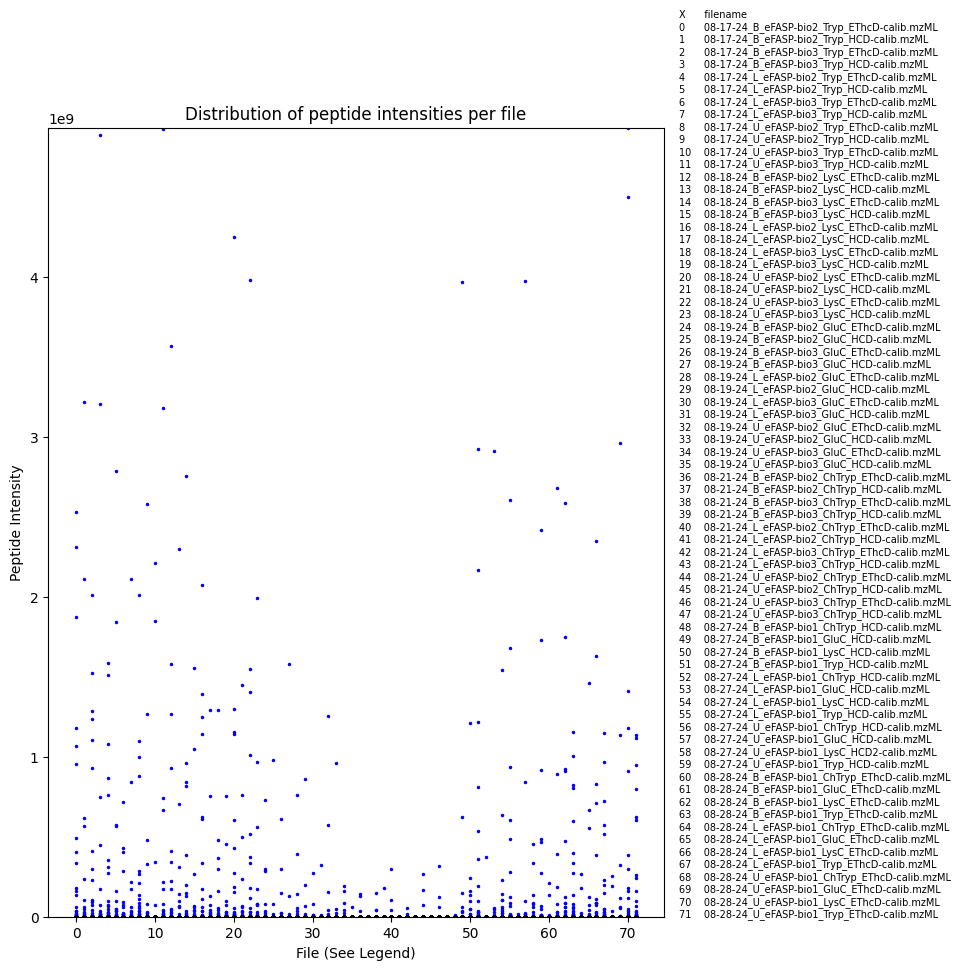

In [52]:
xlabels = sorted(p.spectrafiles)
xpts, ypts = zip(*[(xlabels.index(k), v) for p in pg.peptides for k,v in p.intensities_per_file.items()])
fig, (ax, legend_box) = plt.subplots(1, 2, figsize=(10,10), width_ratios=(0.75, 0.25), layout='tight')
ax.plot(xpts, ypts, 'o', ms=1.5, c='b')

ax.set_ylim(min(ypts) - 5, max(ypts) + 5)
ax.set_title("Distribution of peptide intensities per file")
ax.set_xlabel("File (See Legend)")
ax.set_ylabel("Peptide Intensity")    


xpts, ypts = zip(*[(xlabels.index(k), v) for p in pg.peptides for k,v in p.normalized_intensities_per_file.items()])
ax.plot(xpts, ypts, 'o', ms=1.5, c='k')

col_space = 8
legend_lines = [f"X{' '*(col_space-2)}filename"] + list(map(''.join, [[str(i), ' '*(col_space-2*len(str(i))), l] for i,l in enumerate(xlabels)]))
legend_lines = toolz.interpose('\n', legend_lines)
legend_box.text(0,0, ''.join(legend_lines), fontsize=7)
for i in legend_box.get_children()[1:]:
    i.set_visible(False)
plt.show()